In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from statsmodels.formula.api import ols
import numpy as np
pd.options.display.max_rows = 4000 #ici tu as moins de 4000 lignes dans tout les cas

In [3]:
data = pd.read_csv('../PROJETS/data/train.csv')
data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


# Data exploration and cleaning

In [4]:
data.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [5]:
data.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
Utilities         object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object


In [6]:
data.isnull().sum().sort_values(ascending=False)[:20]

PoolQC          1453
MiscFeature     1406
Alley           1369
Fence           1179
FireplaceQu      690
LotFrontage      259
GarageCond        81
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
BsmtExposure      38
BsmtFinType2      38
BsmtFinType1      37
BsmtCond          37
BsmtQual          37
MasVnrArea         8
MasVnrType         8
Electrical         1
Utilities          0
dtype: int64

In [61]:
#After reading the description.txt, I choose to delete columns that has no interest in my research or are in duplicates
data = data.drop(columns=['Id','Street'],axis=1)

In [62]:
# When NA means 'none' I fill the missing values of the features by 'None'
for col in ('FireplaceQu',
            'Fence',
            'Alley',
            'MiscFeature',
            'PoolQC',
            'GarageType', 
            'GarageFinish', 
            'GarageQual', 
            'GarageCond'):
    data[col]=data[col].fillna('None')
    
#tu peux faire ça quand tu es sûre que ça veut dire None, tu n'as pas démontré que c'est effectivement
#le cas (ou du moins tu n'as pas laissé le code)

In [63]:
# I fill the missing values of the column LotFrontage by the median value
data["LotFrontage"] = data.groupby("Neighborhood")["LotFrontage"].transform(lambda x: x.fillna(x.median()))

In [64]:
# I replace the missing values of the remaining columns by 0
for col in ('GarageYrBlt',
            'BsmtFinType2', 
            'BsmtExposure',
            'BsmtCond',
            'BsmtFinType1', 
            'BsmtQual', 
            'MasVnrArea',
            'MasVnrType',
            'Electrical'):
    data[col]=data[col].fillna(0)
    
#Marwan : Pas forcément la meilleure méthode, par exemple tu donnes une très mauvaise note sur bsmtcond et qual
#alors que c'est pas forcément le cas, et tu aurais pu fill GarageYrBuilt avec la médiane ou le mode,
#pour les maisons qui ont effectivement un garage, sinon 0

In [65]:
# Making false numerical variables into categorical
data['YrSold'] = data['YrSold'].astype(str)
data['OverallCond'] = data['OverallCond'].astype(str)
data['MoSold'] = data['MoSold'].astype(str)
data['MSSubClass'] = data['MSSubClass'].apply(str)



In [66]:
# Encoding the dataframe into another one
encoded_data = pd.get_dummies(data)
encoded_data.head()

,LotFrontage,LotArea,OverallQual,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,...,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,65.0,8450,7,2003,2003,196.0,706,0,150,856,...,0,0,0,1,0,0,0,0,1,0
1,80.0,9600,6,1976,1976,0.0,978,0,284,1262,...,0,0,0,1,0,0,0,0,1,0
2,68.0,11250,7,2001,2002,162.0,486,0,434,920,...,0,0,0,1,0,0,0,0,1,0
3,60.0,9550,7,1915,1970,0.0,216,0,540,756,...,0,0,0,1,1,0,0,0,0,0
4,84.0,14260,8,2000,2000,350.0,655,0,490,1145,...,0,0,0,1,0,0,0,0,1,0


# Data research

In [67]:
# study of the Base variable = SalePrice
data['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

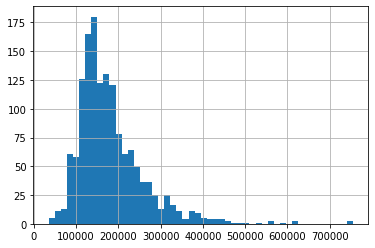

In [68]:
# Displaying distribution of the target variable
data['SalePrice'].hist(bins=50)

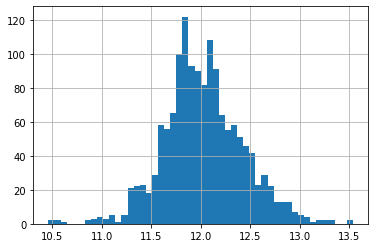

In [69]:
# Adjusting skewed data distribution
data['SalePrice_skewed'] = np.log1p(data['SalePrice']) 
data['SalePrice_skewed'].hist(bins=50)

#très bien, c'est exactement ce qu'il faut faire.

In [70]:
# Displyaing top 10 of data correlated to SalePrice
encoded_data[encoded_data.columns[1:]].corr()['SalePrice'][:].sort_values(ascending=False)[:10]

SalePrice       1.000000
OverallQual     0.790982
GrLivArea       0.708624
GarageCars      0.640409
GarageArea      0.623431
TotalBsmtSF     0.613581
1stFlrSF        0.605852
FullBath        0.560664
BsmtQual_Ex     0.553105
TotRmsAbvGrd    0.533723
Name: SalePrice, dtype: float64

In [71]:
# Correlation matrix (after get dummies to have the categorical values included)
corr = encoded_data.corr()
corr.style.background_gradient(cmap='coolwarm')

#Marwan : c'est très difficile à lire...
#Pense aussi à ne pas laisser tes output, surtout avec un output aussi grand, car cela alourdit fortement 
#ton fichier (il est tellement lourd que tu ne peux pas l'envoyer par mail à ton futur manager par exemple)

# Statistical Analysis

In [1]:
# I choose to study the Ground Live Area vs Sale Price. There is a linear regression 
plt.figure(figsize=(20,8))
sns.regplot(x='GrLivArea', y="SalePrice", data=encoded_data, color='green')


#Marwan :
#Bien.
#Tu aurais pu éliminer des outliers, tu vois par exemple que les deux maisons les plus grandes sont aussi
#hyper bon marché, ce qui n'est pas "normal", tout dépend également de l'état de ces maisons mais on peut
#se pencher plus en détail dessus

NameError: name 'plt' is not defined

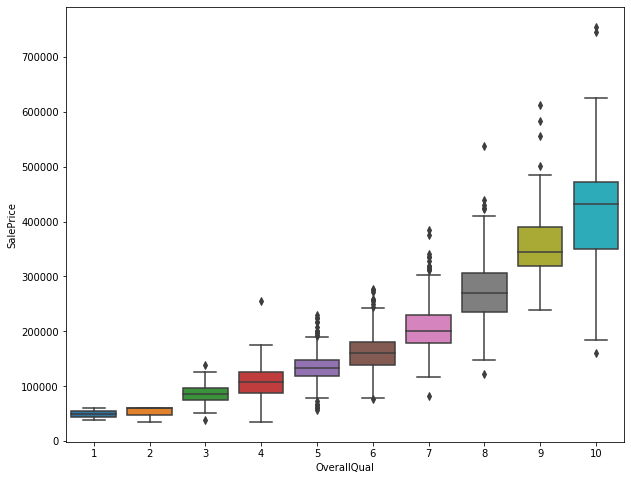

In [73]:
# I choose to study the impact of OverallQual on Sale Price. There is a linear regression 
plt.figure(figsize=(10,8))
sns.boxplot(x="OverallQual", y="SalePrice", data=data)

#ceci n'est pas une regression linéaire mais un boxplot

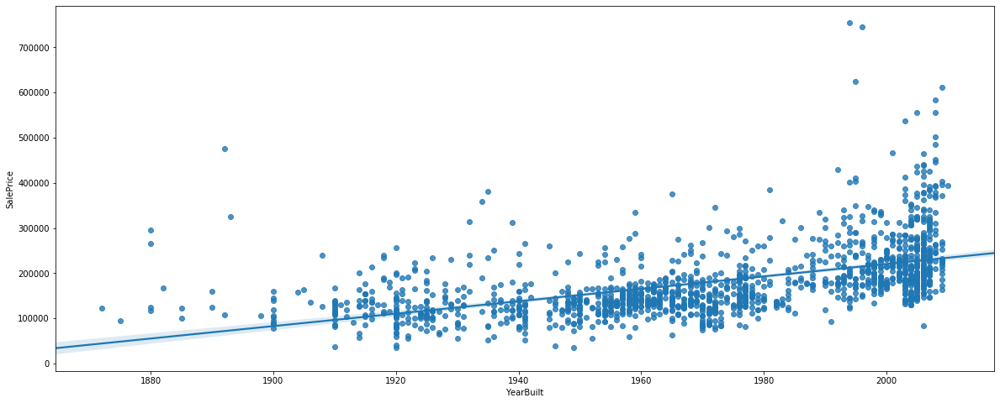

In [74]:
# I choose to study the Year of construction vs Sale Price. There is a linear regression 
plt.figure(figsize=(20,8))
sns.regplot(x='YearBuilt', y="SalePrice", data=data)

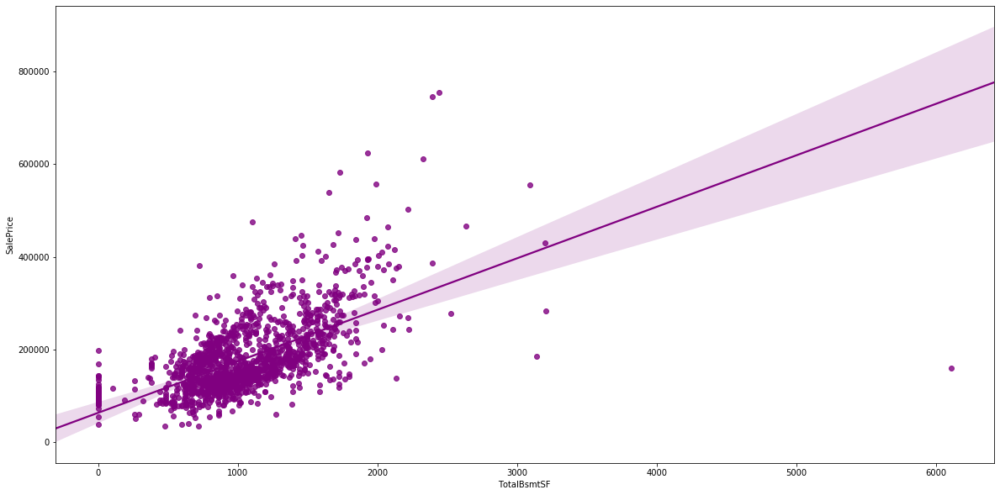

In [75]:
# I choose to study the existence and surface of the basement vs Sale Price. There is a linear regression 
plt.figure(figsize=(20,10))
sns.regplot(x='TotalBsmtSF', y="SalePrice", data=data, color='purple')

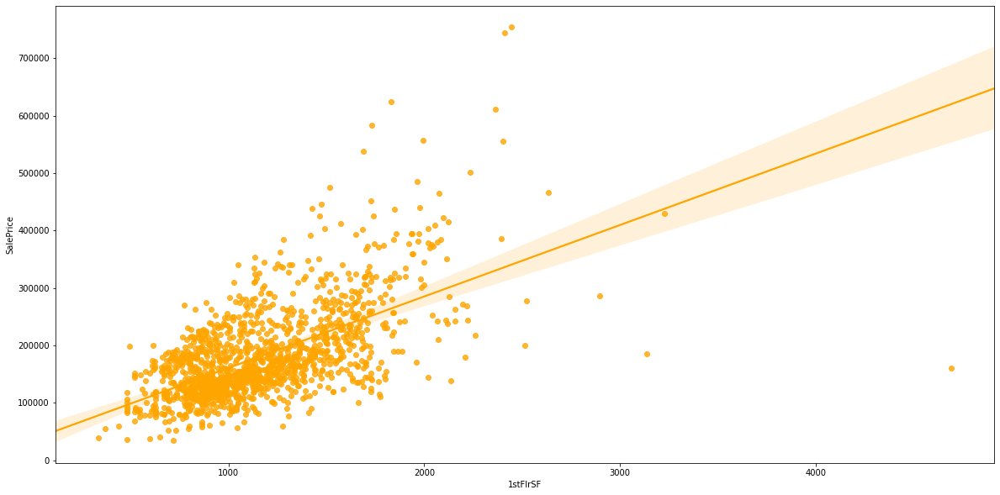

In [76]:
# I choose to study the existence and surface of a first floor vs Sale Price. There is a linear regression 
plt.figure(figsize=(20,10))
sns.regplot(x='1stFlrSF', y="SalePrice", data=data, color='orange')

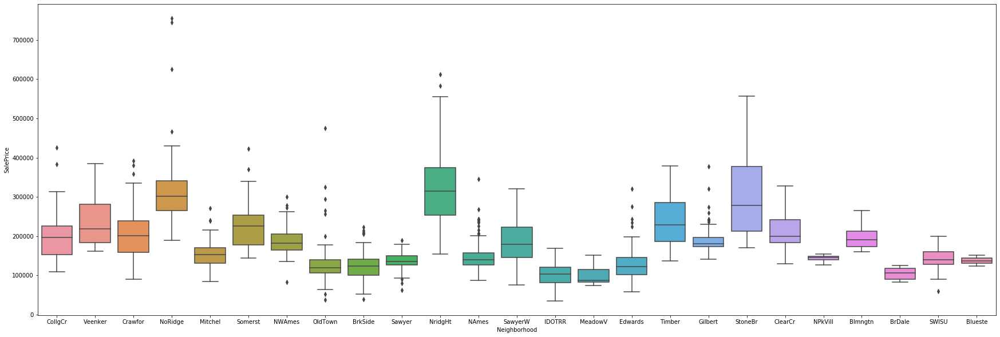

In [77]:
# Even if the correlation coefficient didn't show it, I presumed that the neighborhood had an impact on the Sale Price.
plt.figure(figsize=(30,10))
sns.boxplot(x=data['Neighborhood'], y=data['SalePrice'], data=data)

In [78]:
# Using ANOVA to test H0:the mean SalePrice of every neighborhoods are equals  
model = ols('SalePrice ~ Neighborhood', data = data).fit()
                
anova_result = sm.stats.anova_lm(model, typ=2)
print (anova_result)

                    sum_sq      df          F         PR(>F)
Neighborhood  5.023606e+12    24.0  71.784865  1.558600e-225
Residual      4.184305e+12  1435.0        NaN            NaN


In [79]:
# H0 is rejected : the means are not equal, there is a difference of SalePRice between neighborhoods
# But based on our correlation matrix, it is not the main features to influence the SalePrice

#Marwan : Très bonne analyse. 

C'est dommage que pour les différentes regression linéaires tu n'évalues pas les modèles.
Tu as mis le résultat pour l'anova mais tu t'es contenté de faire des plot2D pour les regressions linéaires que tu as à chaque fois fait avec une seule feature.
Il faut savoir que "dans la vraie vie" les modèles avec 1 ou 2 colonnes ça sera pas fréquent, donc tu ne pourras pas visualiser les résultats.
Par contre, il existes différentes métriques pour évaluer les modèles, comme le R squared ou le MSE, RMSE.
Ici, tu aurais pu montrer le R Squared pour avoir une idée de la performance du modèle, et le RMSE pour voir la différence entre le prix réel et ta prédiction (en $).
Tu dois par contre changer de librairie pour faire ça, car seaborn c'est une librairie de visualisation.
Tu peux donc utiliser scikit-learn ou statsmodel.
Sachant que dans un contexte professionnel ce sera dans la majorité des cas scikit-learn qui sera demandé.